In [1]:
import numpy as np
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

In [2]:
img = Image.open("imag sat/NaturalColorImages.jpg")
img2 = Image.open("imag sat/FalseColorImages.jpg")
images = [img, img2]

In [3]:
def display_images_in_grid(images, titles='',N=2, M=2,display=False,gray=False):

    fig, axs = plt.subplots(N, M, figsize=(15, 15))  
    
    for i, ax in enumerate(axs.flat):  
        if i < len(images): 
            if gray == True :
                ax.imshow(images[i], cmap='gray') 
            else :
                ax.imshow(images[i]) 
            if display == True: 
                ax.set_title(titles[i])  
            ax.axis('off')  
        else:
            ax.axis('off')  

    plt.tight_layout()
    plt.show()
    
def Split_RGB(img):

    img = np.array(img)
    R = img[:, :, 0]  
    G = img[:, :, 1]  
    B = img[:, :, 2]  

    return R, G, B

def Split_RGB_precessing(img):
    RGB_split_images = Split_RGB(img)
    display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
    return RGB_split_images 


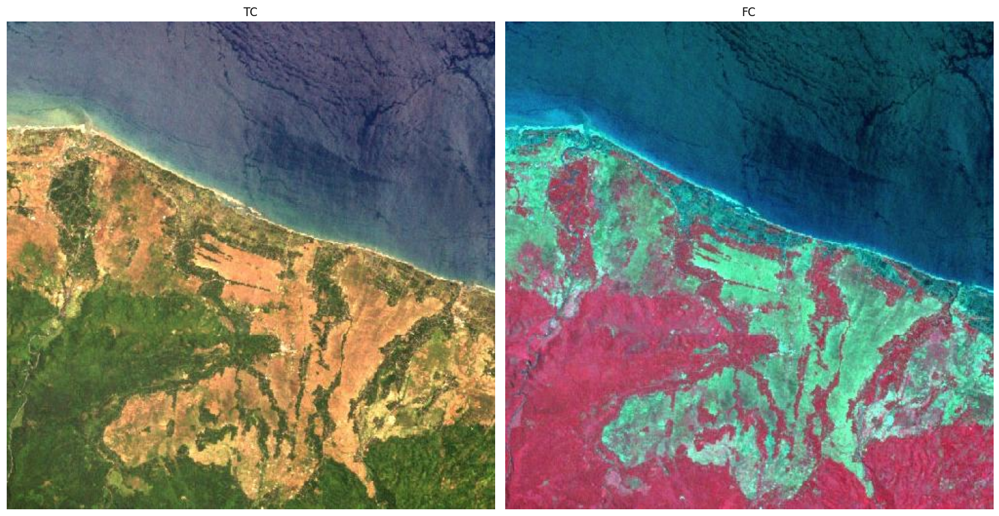

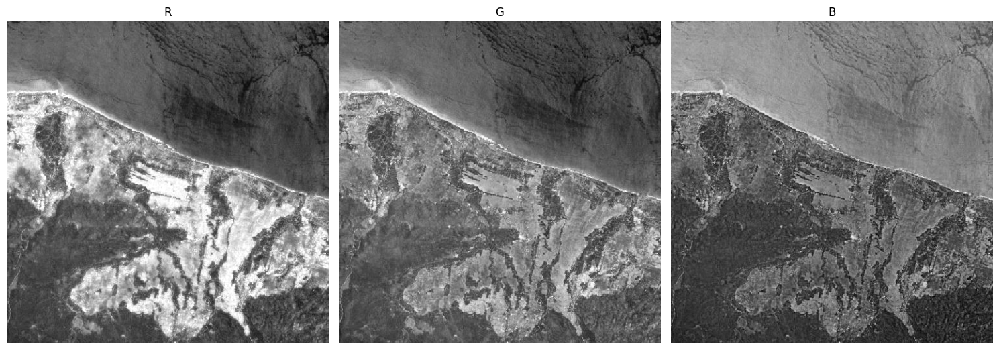

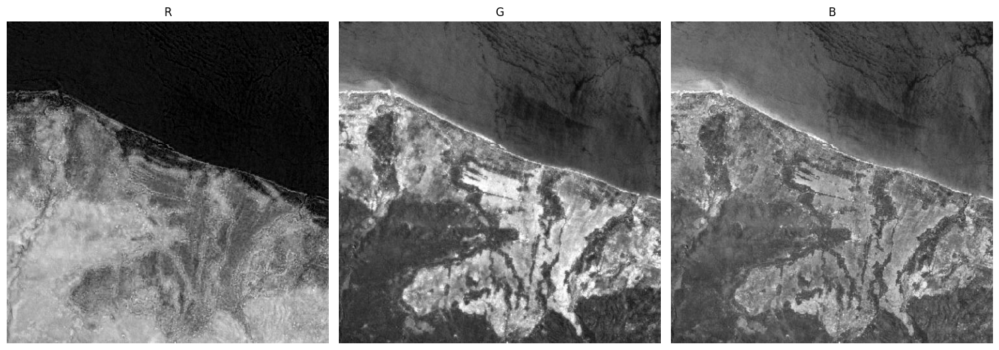

(array([[ 22,  17,  24, ...,  23,  14,   3],
        [  2,   0,   4, ...,  21,  10,   0],
        [  0,   0,   6, ...,  20,   9,   0],
        ...,
        [137, 135, 145, ..., 182, 178, 173],
        [145, 144, 152, ..., 180, 174, 168],
        [150, 152, 158, ..., 180, 171, 163]], dtype=uint8),
 array([[70, 65, 72, ..., 62, 53, 42],
        [52, 48, 54, ..., 60, 49, 36],
        [44, 51, 63, ..., 62, 51, 38],
        ...,
        [54, 47, 50, ..., 82, 79, 74],
        [60, 56, 57, ..., 75, 69, 63],
        [62, 63, 63, ..., 69, 60, 52]], dtype=uint8),
 array([[119, 114, 121, ...,  77,  68,  57],
        [101,  97, 103, ...,  75,  64,  51],
        [ 91,  98, 108, ...,  78,  67,  54],
        ...,
        [ 74,  69,  74, ..., 110, 107, 102],
        [ 81,  78,  81, ..., 105,  99,  93],
        [ 84,  85,  87, ..., 101,  92,  84]], dtype=uint8))

In [4]:
display_images_in_grid(images,['TC','FC'],1,2,True,True)
Split_RGB_precessing(img)
Split_RGB_precessing(img2)

## Etape 1 : Rehaussement de contours

In [14]:
def convolve(image, kernel):
    fh, fw = kernel.shape
    ih, iw = image.shape
    filtered_image = np.zeros_like(image)
    padded_image = np.pad(image, ((fh // 2, fh // 2), (fw // 2, fw // 2)), mode='reflect')

    for y in range(ih):
        for x in range(iw):
            window = padded_image[y:y + fh, x:x + fw]
            result = np.sum(window * kernel)
            filtered_image[y, x] = result

    return filtered_image

In [13]:
def median_filter(image):

    filtered_image = np.zeros_like(image)
    for y in range(1, image.shape[0] - 1): 
        for x in range(1, image.shape[1] - 1):
            window = image[y - 1:y + 2, x - 1:x + 2] 
            sort = np.sort(window)
            median = np.median(sort)
            filtered_image[y, x] = median
    #padding
    filtered_image[:1, :] = image[:1, :]
    filtered_image[-1:, :] = image[-1:, :]
    filtered_image[:, :1] = image[:, :1]
    filtered_image[:, -1:] = image[:, -1:]        

    return filtered_image

In [12]:
def gaussian_kernel(size, sigma):
    k = size // 2
    kernel = np.zeros((size, size))
    
    for x in range(-k, k+1):
        for y in range(-k, k+1):
            kernel[x+k, y+k] = (1 / (2 * np.pi * sigma**2)) * np.exp(-(x**2 + y**2) / (2 * sigma**2))
    
    return kernel / kernel.sum()

In [10]:
def amplitude_direction(edges_y, edges_x):

    amplitude = np.sqrt(edges_x**2 + edges_y**2)
    direction = np.arctan2(edges_y, edges_x)
    
    return amplitude,direction


In [11]:
def manual_binary_edges(amplitude, threshold):

    binary_edges = np.zeros_like(amplitude, dtype=np.uint8)
    
    #  'binary_edges' où 'amplitude' est supérieur au seuil par 255
    for i in range(amplitude.shape[0]):
        for j in range(amplitude.shape[1]):
            if amplitude[i, j] > threshold:
                binary_edges[i, j] = 255
    
    return binary_edges

In [8]:
def sobel(image, threshold):
    image_array = np.array(image, dtype=np.float64)

    sobel_x = np.array([[-1, 0, 1],
                        [-2, 0, 2],
                        [-1, 0, 1]])

    sobel_y = np.array([[-1, -2, -1],
                        [ 0,  0,  0],
                        [ 1,  2,  1]])

    edges_x = convolve(image_array, sobel_x)
    edges_y = convolve(image_array, sobel_y)

    # Calculer la magnitude des gradients
    amplitude,direction = amplitude_direction(edges_y, edges_x)
    
    binary_edges = manual_binary_edges(amplitude, threshold)
    
    binary_edges_image = Image.fromarray(binary_edges)

    edge_positions = np.argwhere(binary_edges)

    return binary_edges_image, edge_positions, amplitude, direction

def prewitt(image, threshold):
    image_array = np.array(image, dtype=np.float64)

    prewitt_x = np.array([[-1, 0, 1],
                          [-1, 0, 1],
                          [-1, 0, 1]])

    prewitt_y = np.array([[-1, -1, -1],
                          [ 0,  0,  0],
                          [ 1,  1,  1]])

    edges_x = convolve(image_array, prewitt_x)
    edges_y = convolve(image_array, prewitt_y)

    amplitude,direction = amplitude_direction(edges_y, edges_x)

    # Convertir la magnitude des gradients en image
    edges_image = Image.fromarray(np.clip(amplitude, 0, 255).astype(np.uint8))
    
    binary_edges = manual_binary_edges(amplitude, threshold)
    
    binary_edges_image = Image.fromarray(binary_edges)

    edge_positions = np.argwhere(binary_edges)

    return binary_edges_image, edge_positions, amplitude, direction

def laplacian(image, threshold):
    # Noyau Laplacien
    smoothed_image = median_filter(image)
    laplacian_kernel = np.array([[ 0, -1,  0],
                                 [-1,  4, -1],
                                 [ 0, -1,  0]])

    laplacian_result = convolve(smoothed_image, laplacian_kernel)
    laplacian_result = median_filter(laplacian_result)

    # Conversion des valeurs pour visualisation
    laplacian_image = Image.fromarray(np.clip(np.abs(laplacian_result), 0, 255).astype(np.uint8))

    # Binarisation après application d'un seuil
    binary_edges = manual_binary_edges(np.abs(laplacian_result), threshold)
    binary_edges_image = Image.fromarray(binary_edges)

    return binary_edges_image, laplacian_image



def log_filter(image, kernel_size, sigma, threshold):
   
    # Étape 1 : Lissage avec le noyau gaussien
    gaussian_k = gaussian_kernel(kernel_size, sigma)
    smoothed_image = convolve(image, gaussian_k)
    
    # Étape 2 : Application du Laplacien sur l'image lissée
    laplacian_k = np.array([[ 0, -1,  0],
                            [-1,  4, -1],
                            [ 0, -1,  0]])
    log_result = convolve(smoothed_image, laplacian_k)
    log_result = median_filter(log_result)

    # Conversion pour visualisation
    log_gradient_image = Image.fromarray(np.clip(np.abs(log_result), 0, 255).astype(np.uint8))

    # Binarisation après application d'un seuil
    binary_edges = manual_binary_edges(np.abs(log_result), threshold)
    binary_edges_image = Image.fromarray(binary_edges)

    return binary_edges_image, log_gradient_image

Filtre Sobel sur True Color Composition

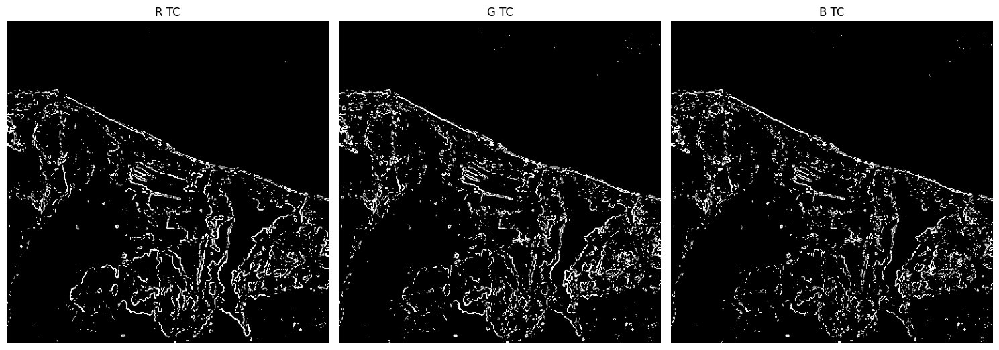

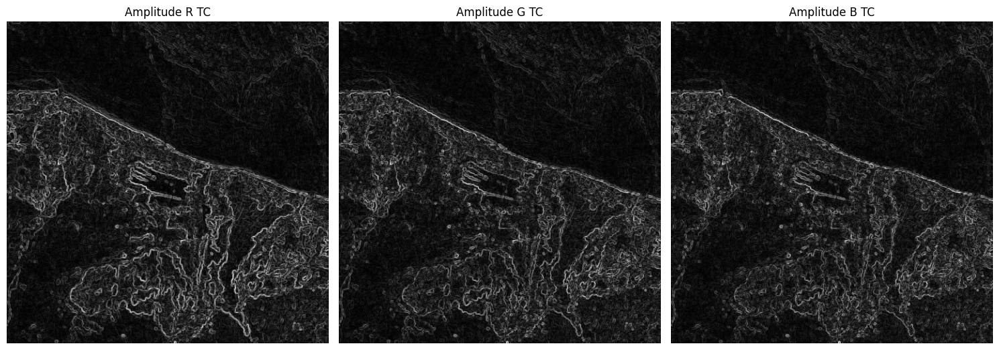

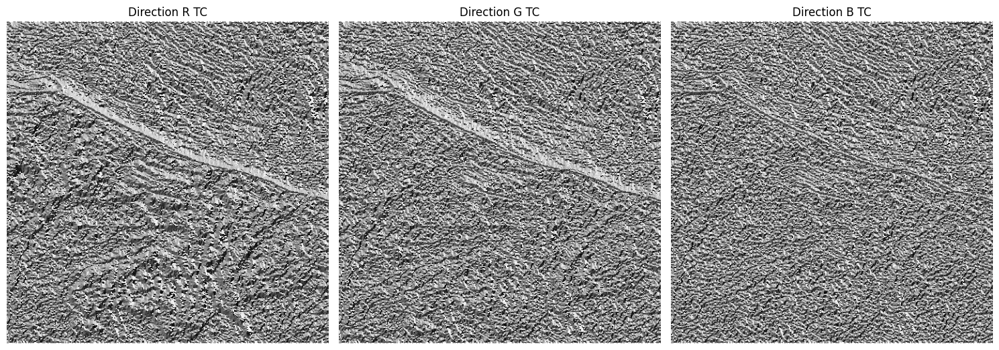

In [15]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_TC_edges, _, amplitude_TC_red, direction_TC_red = sobel(red_TC, 250)
green_TC_edges, _, amplitude_TC_green, direction_TC_green = sobel(green_TC, 210)
blue_TC_edges, _, amplitude_TC_blue, direction_TC_blue = sobel(blue_TC, 210)

rgbchannels_TC = [red_TC_edges, green_TC_edges, blue_TC_edges]
amplitudes_TC = [amplitude_TC_red, amplitude_TC_green, amplitude_TC_blue]
directions_TC = [direction_TC_red, direction_TC_green, direction_TC_blue]

display_images_in_grid(rgbchannels_TC,['R TC','G TC','B TC'],1,3,True,True)
display_images_in_grid(amplitudes_TC, ['Amplitude R TC', 'Amplitude G TC', 'Amplitude B TC'], 1, 3, True, True)
display_images_in_grid(directions_TC, ['Direction R TC', 'Direction G TC', 'Direction B TC'], 1, 3, True, True)

#Filtre Sobel sur False Color Composition

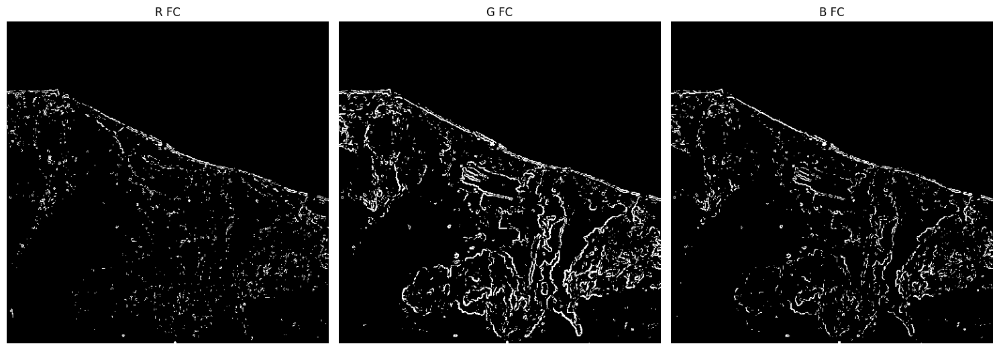

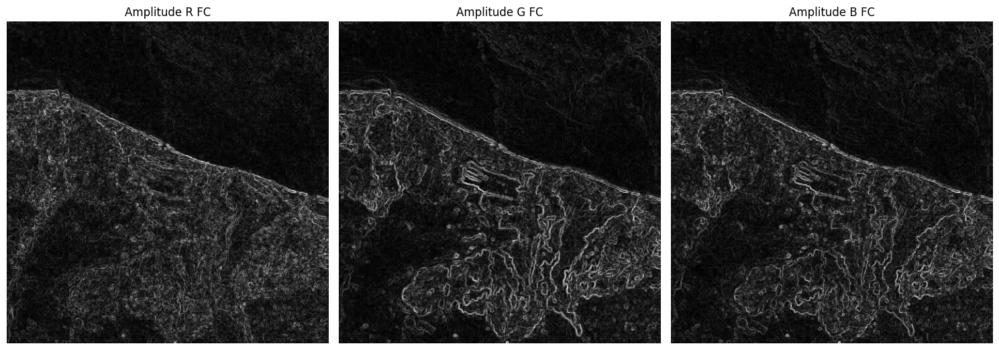

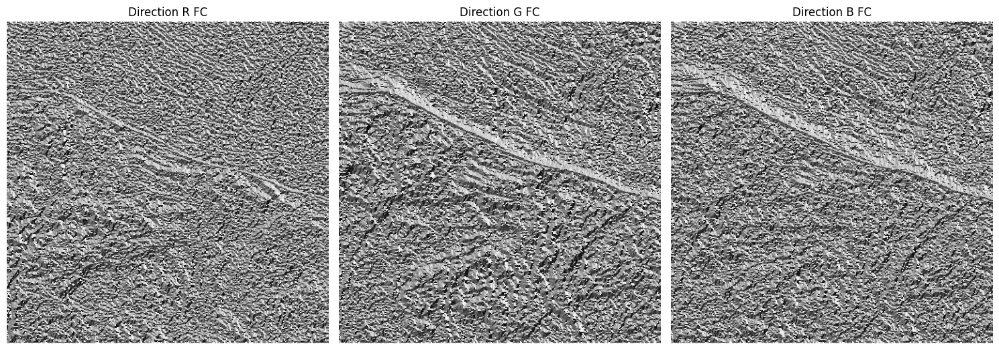

In [16]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_FC_edges, _, amplitude_FC_red, direction_FC_red = sobel(red_FC, 210)
green_FC_edges, _, amplitude_FC_green, direction_FC_green = sobel(green_FC, 210)
blue_FC_edges, _, amplitude_FC_blue, direction_FC_blue = sobel(blue_FC, 210)

rgbchannels_FC = [red_FC_edges, green_FC_edges, blue_FC_edges]
amplitudes_FC = [amplitude_FC_red, amplitude_FC_green, amplitude_FC_blue]
directions_FC = [direction_FC_red, direction_FC_green, direction_FC_blue]

display_images_in_grid(rgbchannels_FC,['R FC','G FC','B FC'],1,3,True,True)
display_images_in_grid(amplitudes_FC, ['Amplitude R FC', 'Amplitude G FC', 'Amplitude B FC'], 1, 3, True, True)
display_images_in_grid(directions_FC, ['Direction R FC', 'Direction G FC', 'Direction B FC'], 1, 3, True, True)

Filtre Prewitt sur True Color Composition

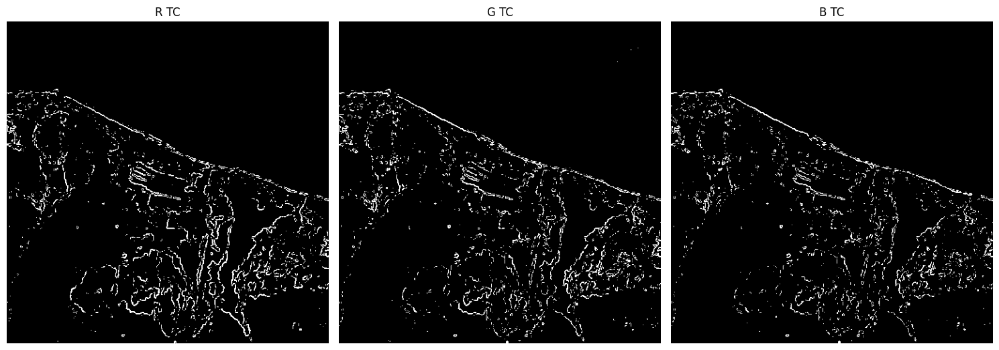

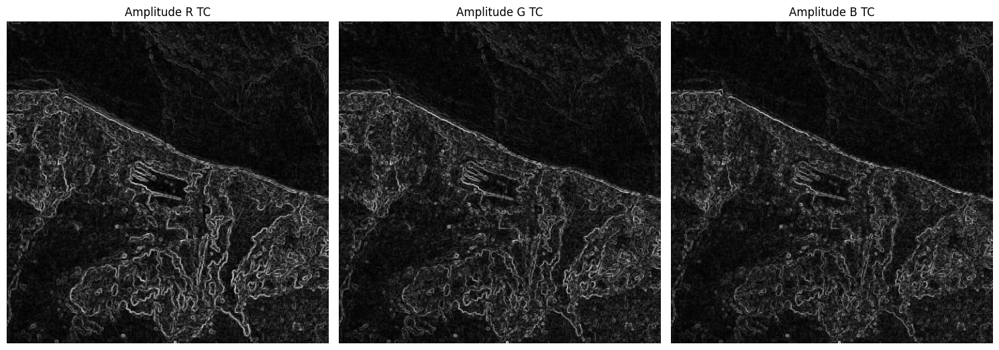

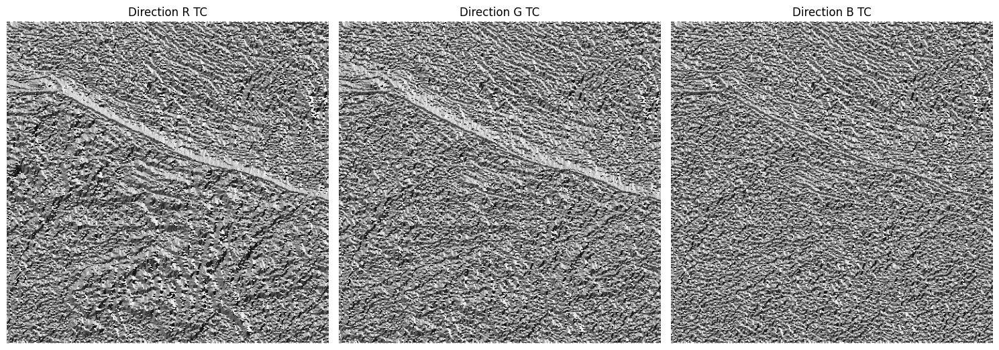

In [17]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_TC_edges, _, amplitude_TC_red, direction_TC_red = prewitt(red_TC, 200)
green_TC_edges, _, amplitude_TC_green, direction_TC_green = prewitt(green_TC, 180)
blue_TC_edges, _, amplitude_TC_blue, direction_TC_blue = prewitt(blue_TC, 180)

rgbchannels_TC = [red_TC_edges, green_TC_edges, blue_TC_edges]
amplitudes_TC = [amplitude_TC_red, amplitude_TC_green, amplitude_TC_blue]
directions_TC = [direction_TC_red, direction_TC_green, direction_TC_blue]

display_images_in_grid(rgbchannels_TC,['R TC','G TC','B TC'],1,3,True,True)
display_images_in_grid(amplitudes_TC, ['Amplitude R TC', 'Amplitude G TC', 'Amplitude B TC'], 1, 3, True, True)
display_images_in_grid(directions_TC, ['Direction R TC', 'Direction G TC', 'Direction B TC'], 1, 3, True, True)

Filtre Prewitt sur False Color Composition

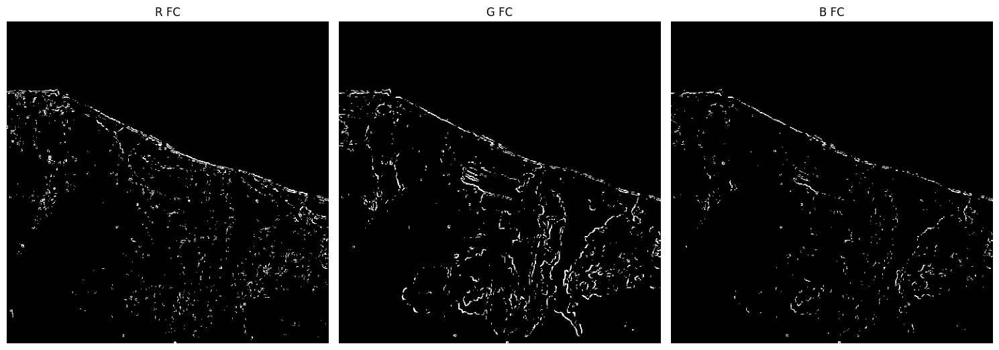

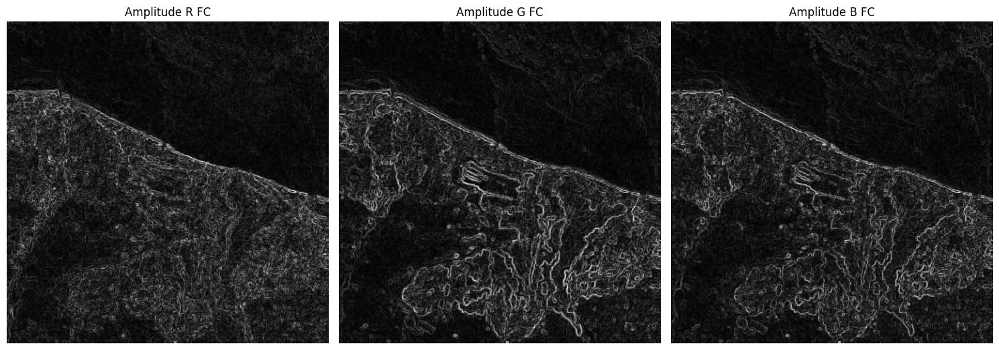

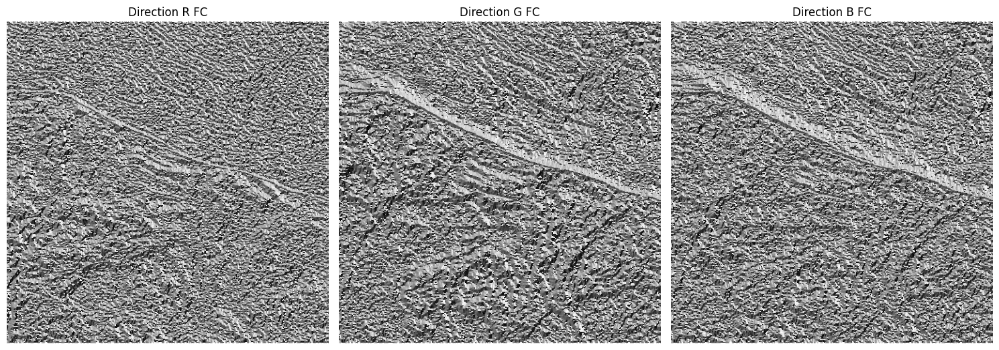

In [18]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_FC_edges, _, amplitude_FC_red, direction_FC_red = prewitt(red_FC, 160)
green_FC_edges, _, amplitude_FC_green, direction_FC_green = prewitt(green_FC, 210)
blue_FC_edges, _, amplitude_FC_blue, direction_FC_blue = prewitt(blue_FC, 210)

rgbchannels_FC = [red_FC_edges, green_FC_edges, blue_FC_edges]
amplitudes_FC = [amplitude_FC_red, amplitude_FC_green, amplitude_FC_blue]
directions_FC = [direction_FC_red, direction_FC_green, direction_FC_blue]

display_images_in_grid(rgbchannels_FC,['R FC','G FC','B FC'],1,3,True,True)
display_images_in_grid(amplitudes_FC, ['Amplitude R FC', 'Amplitude G FC', 'Amplitude B FC'], 1, 3, True, True)
display_images_in_grid(directions_FC, ['Direction R FC', 'Direction G FC', 'Direction B FC'], 1, 3, True, True)

Filtre Laplacien sur True Color Composition

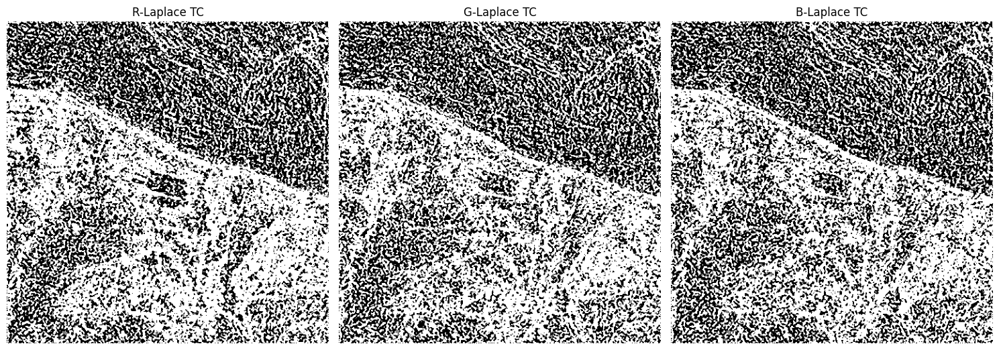

In [19]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_laplace_edges, red_laplace_gradient = laplacian(red_TC, 20)
green_laplace_edges, green_laplace_gradient = laplacian(green_TC, 20)
blue_laplace_edges, blue_laplace_gradient = laplacian(blue_TC, 20)

laplacian_channels = [red_laplace_edges, green_laplace_edges, blue_laplace_edges]
gradients = [red_laplace_gradient, green_laplace_gradient, blue_laplace_gradient]

display_images_in_grid(laplacian_channels, ['R-Laplace TC', 'G-Laplace TC', 'B-Laplace TC'], 1, 3, True, True)

Filtre Laplacien sur False Color Composition

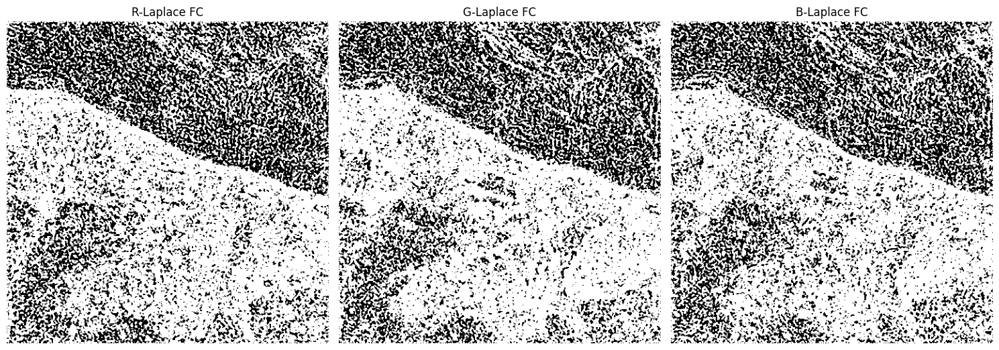

In [20]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_laplace_edges, red_laplace_gradient = laplacian(red_FC, 10)
green_laplace_edges, green_laplace_gradient = laplacian(green_FC, 10)
blue_laplace_edges, blue_laplace_gradient = laplacian(blue_FC, 10)

laplacian_channels = [red_laplace_edges, green_laplace_edges, blue_laplace_edges]
gradients = [red_laplace_gradient, green_laplace_gradient, blue_laplace_gradient]

display_images_in_grid(laplacian_channels, ['R-Laplace FC', 'G-Laplace FC', 'B-Laplace FC'], 1, 3, True, True)

Filtre LOG sur True Color Composition

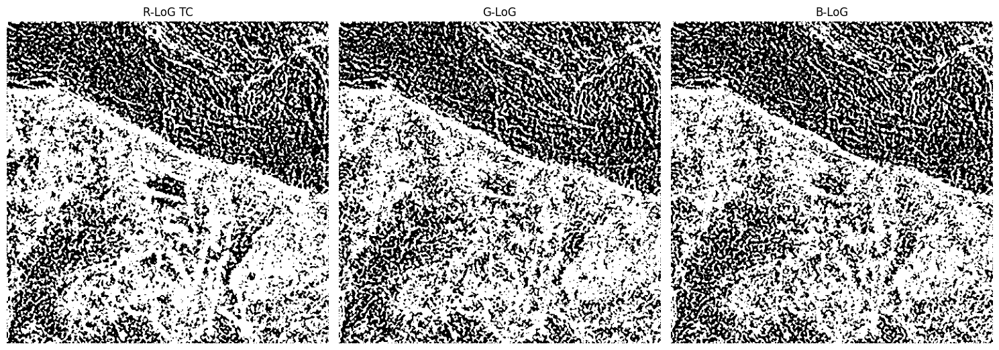

In [65]:
red_TC, green_TC, blue_TC = Split_RGB(img)

red_log_edges, red_log_gradient = log_filter(red_TC, kernel_size=5, sigma=1.5, threshold=5)
green_log_edges, green_log_gradient = log_filter(green_TC, kernel_size=5, sigma=1.5, threshold=5)
blue_log_edges, blue_log_gradient = log_filter(blue_TC, kernel_size=5, sigma=1.5, threshold=5)

log_channels = [red_log_edges, green_log_edges, blue_log_edges]
log_gradients = [red_log_gradient, green_log_gradient, blue_log_gradient]

# Afficher les bords binaires des canaux LoG
display_images_in_grid(log_channels, ['R-LoG TC', 'G-LoG', 'B-LoG'], 1, 3, True, True)

Filtre LOG sur False Color Composition

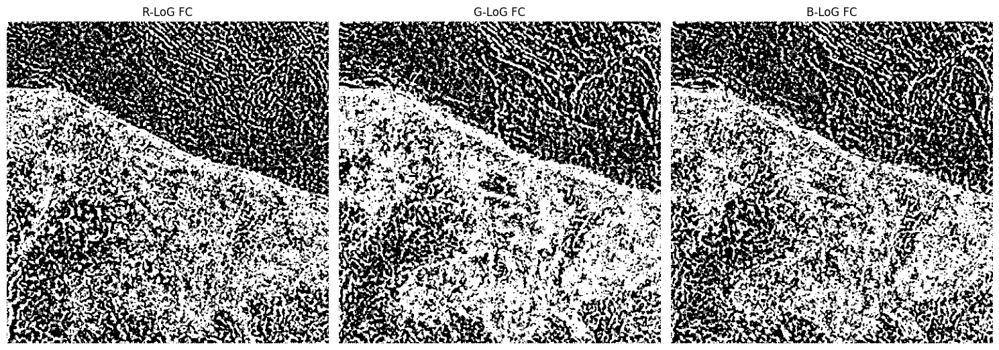

In [21]:
red_FC, green_FC, blue_FC = Split_RGB(img2)

red_log_edges, red_log_gradient = log_filter(red_FC, kernel_size=5, sigma=3, threshold=5)
green_log_edges, green_log_gradient = log_filter(green_FC, kernel_size=5, sigma=3, threshold=5)
blue_log_edges, blue_log_gradient = log_filter(blue_FC, kernel_size=5, sigma=3, threshold=5)

log_channels = [red_log_edges, green_log_edges, blue_log_edges]
log_gradients = [red_log_gradient, green_log_gradient, blue_log_gradient]

# Afficher les bords binaires des canaux LoG
display_images_in_grid(log_channels, ['R-LoG FC', 'G-LoG FC', 'B-LoG FC'], 1, 3, True, True)

# # Etape 2 : Segmentation 

In [5]:
def display_histograms(images, titles='',N=2, M=2,display=False):
    fig, axs = plt.subplots(N, M, figsize=(15, 5)) 

    for i, ax in enumerate(axs.flat):  
        if i < len(images):  
    
            ax.hist(images[i].flatten(), bins=256)
            if display == True: 
                ax.set_title(titles[i])
            ax.axis('on') 
    plt.tight_layout()
    plt.show()  

def display_histogram(histogram, title):
    plt.figure(figsize=(10, 5))
    plt.bar(range(len(histogram)), histogram)
    plt.title(title)
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.show()

In [6]:
def calculate_histogram(channel):
    return np.histogram(channel, bins=256, range=(0, 255))[0]

def calculate_histograms(image):
    if isinstance(image, Image.Image):
        image = np.array(image)
    
    red = image[:, :, 0]  
    green = image[:, :, 1]  
    blue = image[:, :, 2]
    
    rhist = calculate_histogram(red)
    ghist = calculate_histogram(green)
    bhist = calculate_histogram(blue)
    
    return rhist, ghist, bhist

In [32]:
def binary_segmentation(image, n1, n2, previous_segments):

    if previous_segments:
        for segment in previous_segments:
            image[segment] = 0
    
    binary_image = np.zeros_like(image, dtype=bool)
    binary_image[(image >= n1) & (image <= n2)] = True
    
    return binary_image

def find_peak(histogram, half_width):
    max_value = -1
    n1, n2 = -1, -1
    
    for i in range(1, len(histogram) - 1):
        if histogram[i] > histogram[i - 1] and histogram[i] > histogram[i + 1]:
            # left = histogram[i-1]
            # right = histogram[i+1]
            # prev_l = i
            # prev_r = i
            # while left < histogram[prev_l]:
            #     left = max(0, histogram[prev_l-2])
            #     prev_l = i-1
            # while right < histogram[prev_r]:
            #     right = min(histogram[prev_r+2],255)
            #     prev_r = i+1
            left = max(0, i - half_width)
            right = min(255, i + half_width)
            
            if histogram[i] > max_value:
                max_value = histogram[i]
                n1, n2 = left, right
    
    return n1, n2, max_value

def subtract_segmented_region(image, segment):
    if isinstance(image, Image.Image):  
        image_array = np.array(image)
    else:
        image_array = image.copy()  
    
    image_array[segment] = 0
    return image_array 

def is_image_empty(image):
    if isinstance(image, Image.Image):
        image = np.array(image)
    return np.all(image == 0)

def segments_image(image, half_width, max_segments=2):
    if isinstance(image, Image.Image):
        image = np.array(image)
    
    original_image = image.copy()  
    segmented_regions = []
    previous_segments = []
    image_regions = []
    plt.imshow(image)
    
    while not is_image_empty(image):


        #calculate histogram
        rhist, ghist, bhist = calculate_histograms(image)
        histograms = [rhist, ghist, bhist]
        names = ['R', 'G', 'B']

        for hist, name in zip(histograms, names):
            display_histogram(hist, name)

        
        #choose best n 1 and n2 to segment
        best_n1, best_n2 = -1, -1
        best_max_value = -1
        best_channel_index = -1
        
        for i, histogram in enumerate(histograms):
            n1, n2, max_value = find_peak(histogram, half_width)
            
            if max_value > best_max_value:
                best_n1, best_n2 = n1, n2
                best_max_value = max_value
                best_channel_index = i
        
        if best_n1 == -1 or best_n2 == -1:
            print("No valid peak found")
            break
        
        #segment part image
        if best_channel_index == 0:
            segment = binary_segmentation(image[:,:,0], best_n1, best_n2, previous_segments)
            print("Red channel histogram was chosen.")
        elif best_channel_index == 1:
            segment = binary_segmentation(image[:,:,1], best_n1, best_n2, previous_segments)
            print("Green channel histogram was chosen.")
        else:
            segment = binary_segmentation(image[:,:,2], best_n1, best_n2, previous_segments)
            print("Blue channel histogram was chosen.")
        
        segmented_regions.append(segment)
        previous_segments.append(segment)
        
        image = subtract_segmented_region(image, segment)
        
        image2 = subtract_segmented_region(original_image, segment)
        plt.imshow(image2)
        image_regions.append(image2)

        remaining_pixels = np.count_nonzero(image)
        if remaining_pixels < 100:
            print(f"Nombre de pixels restants ({remaining_pixels}) insuffisant pour continuer.")
            break
    
    return segmented_regions, image_regions


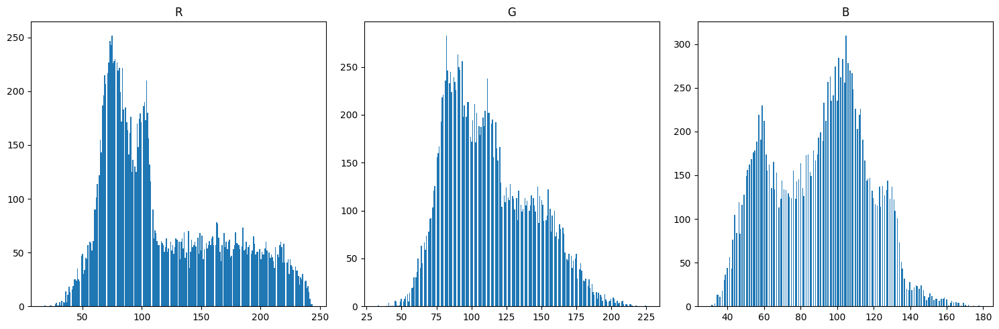

In [8]:
resized_image = img.resize((128, 128)) 
smoothed_img = gaussian_filter(resized_image, sigma=0.5) 
red, green, blue = Split_RGB(smoothed_img)
display_histograms([red, green, blue ],['R','G','B'],1,3,True)

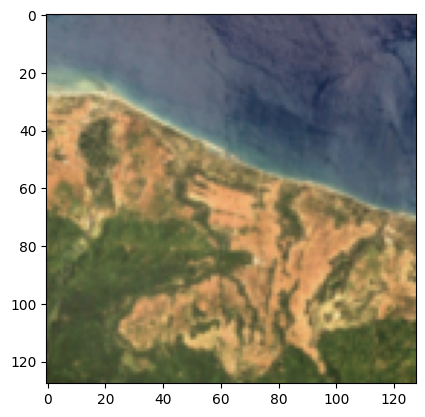

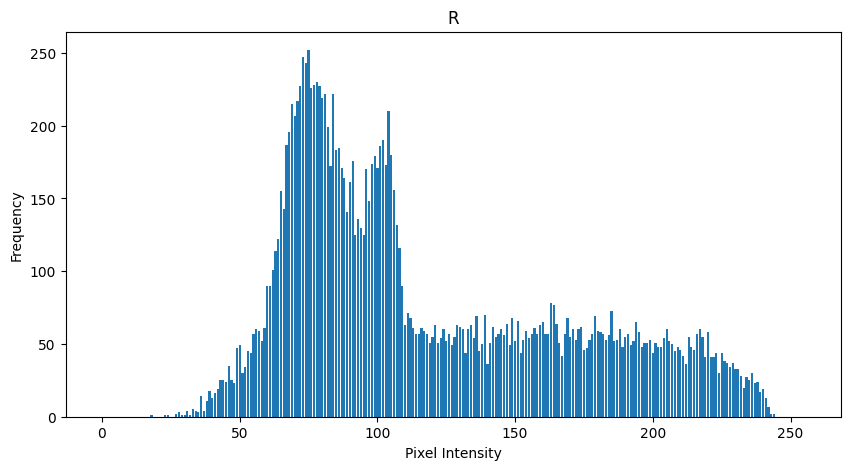

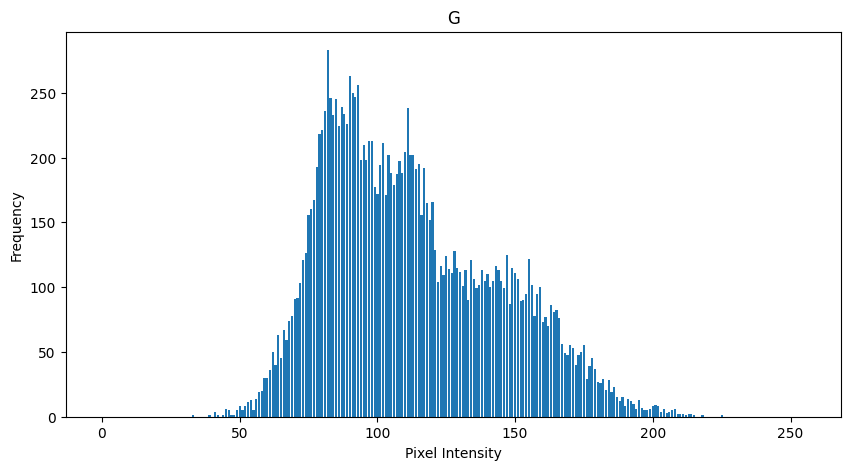

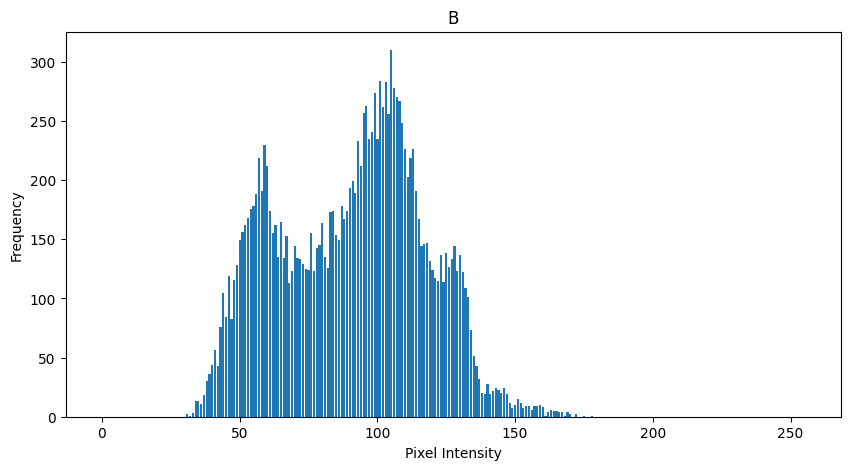

Blue channel histogram was chosen.


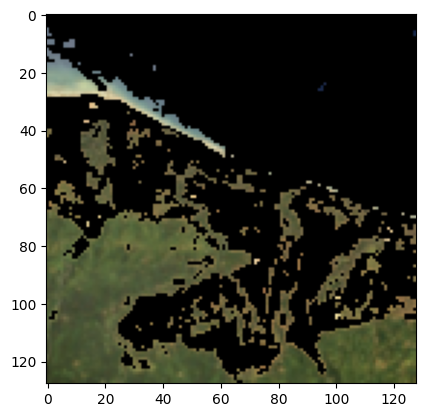

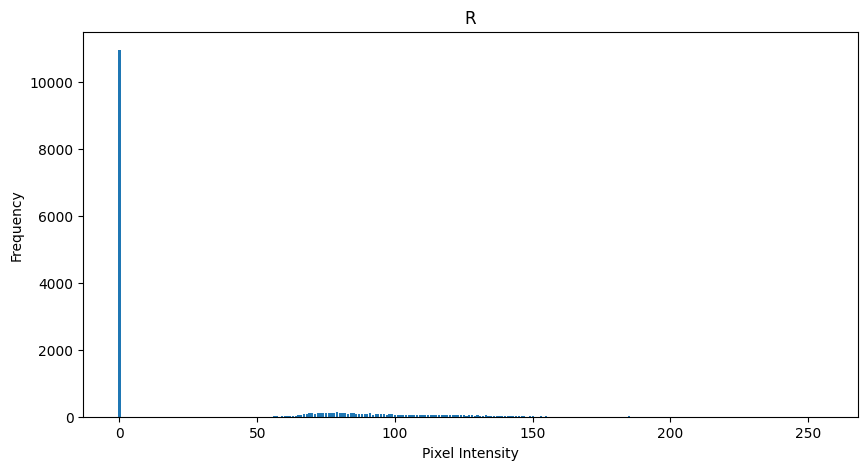

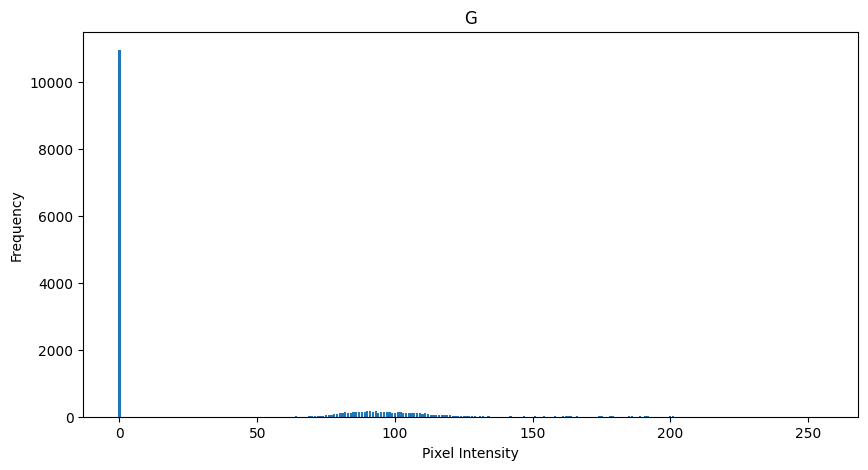

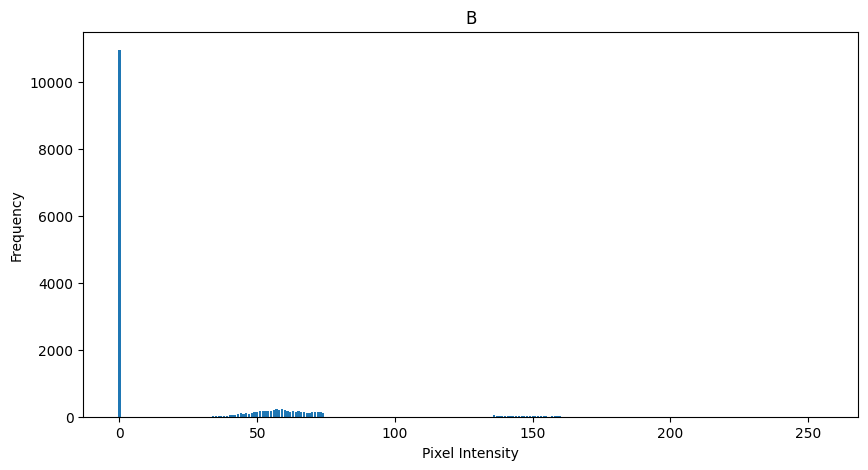

Blue channel histogram was chosen.


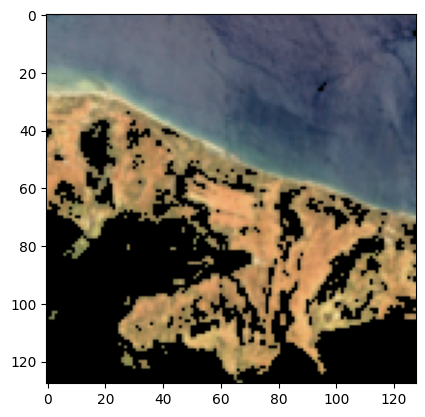

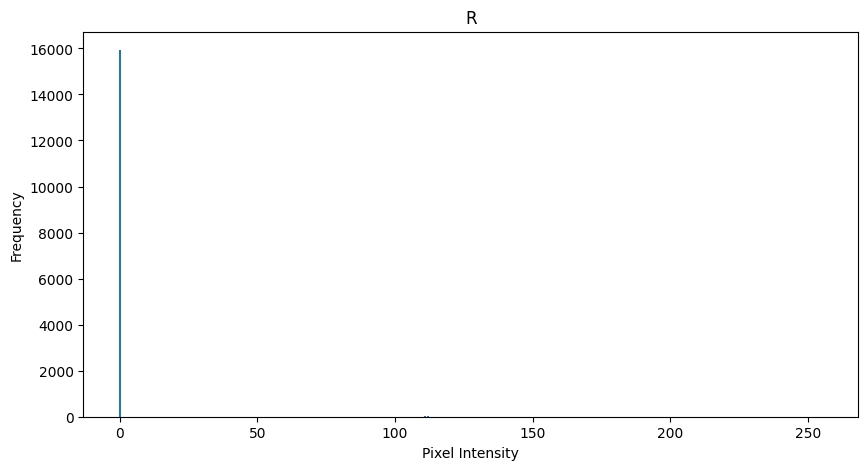

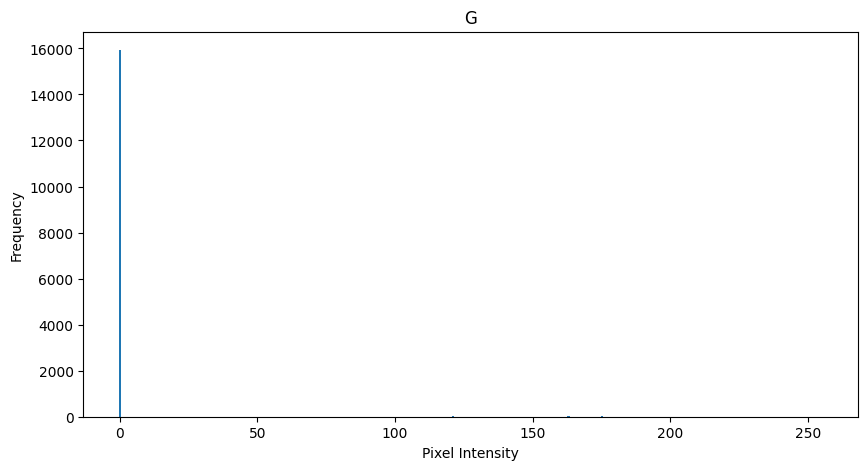

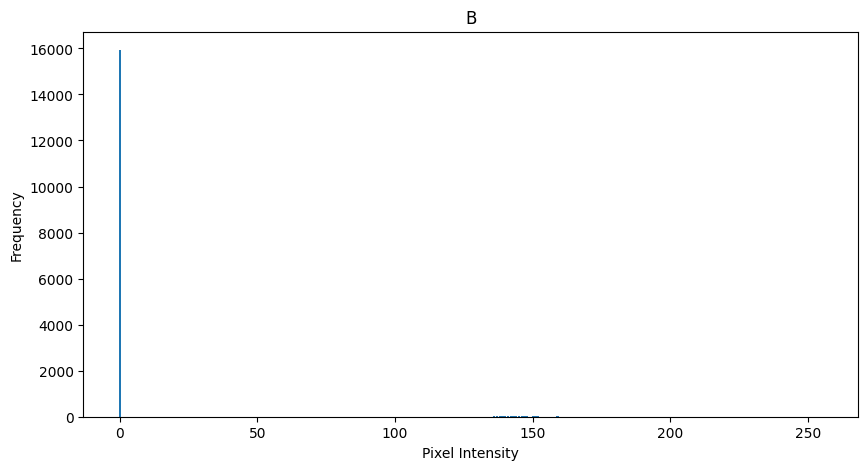

Blue channel histogram was chosen.
Nombre de pixels restants (45) insuffisant pour continuer.


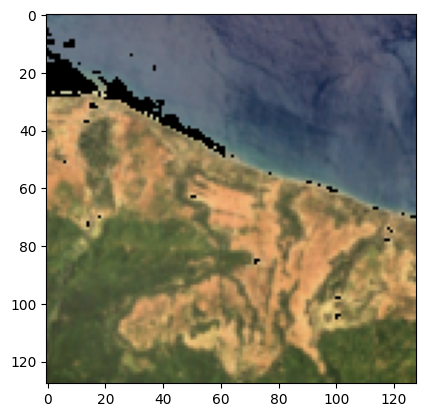

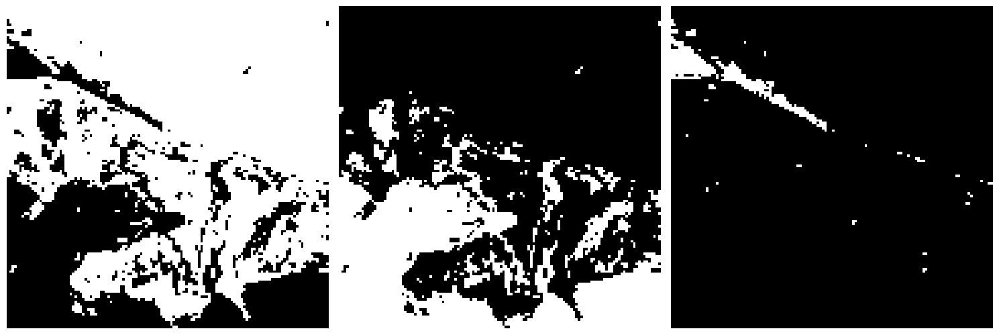

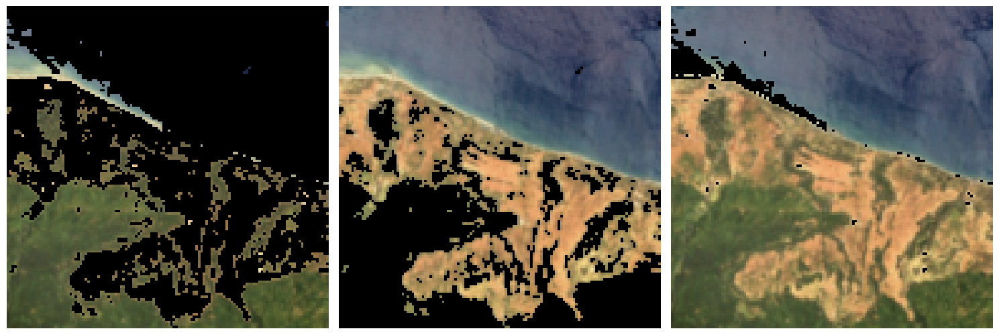

In [33]:
resized_image = img.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_img = gaussian_filter(resized_image, sigma=0.5) 
segmentes, segmented_images = segments_image(smoothed_img, 30)
n = len(segmented_images)
display_images_in_grid(segmentes,['','',''],1,n,False,True)
display_images_in_grid(segmented_images,['','',''],1,n,False,True)

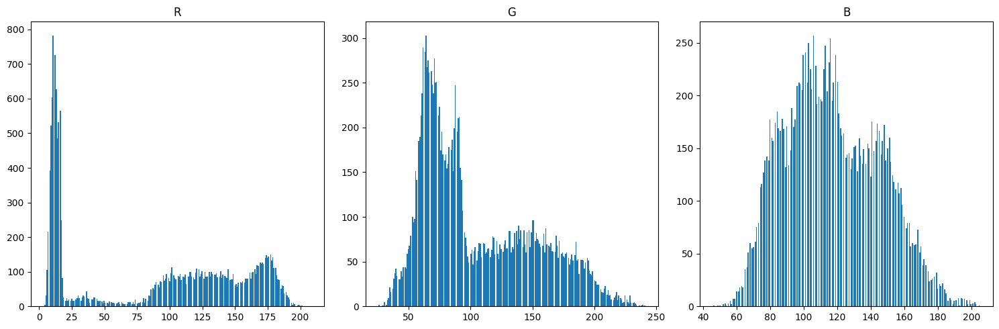

In [28]:
resized_image = img2.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_red =  gaussian_filter(red, sigma=1) 
smoothed_green = gaussian_filter(green, sigma=1) 
smoothed_blue =  gaussian_filter(blue, sigma=1) 
display_histograms([smoothed_red, smoothed_green, smoothed_blue],['R','G','B'],1,3,True)

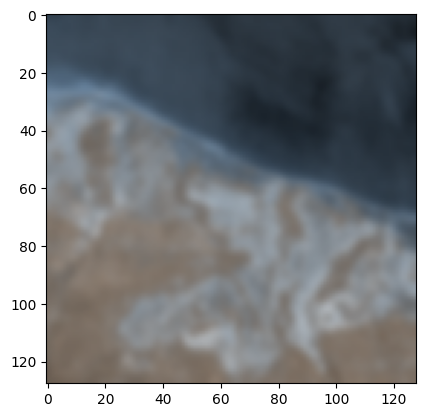

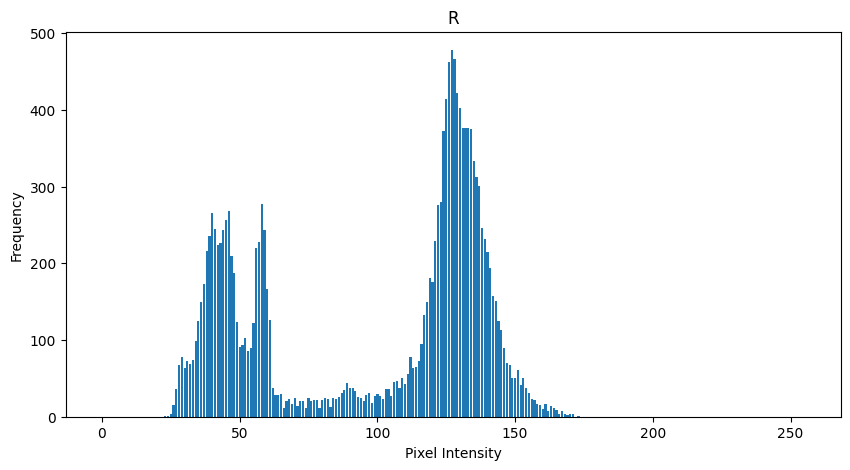

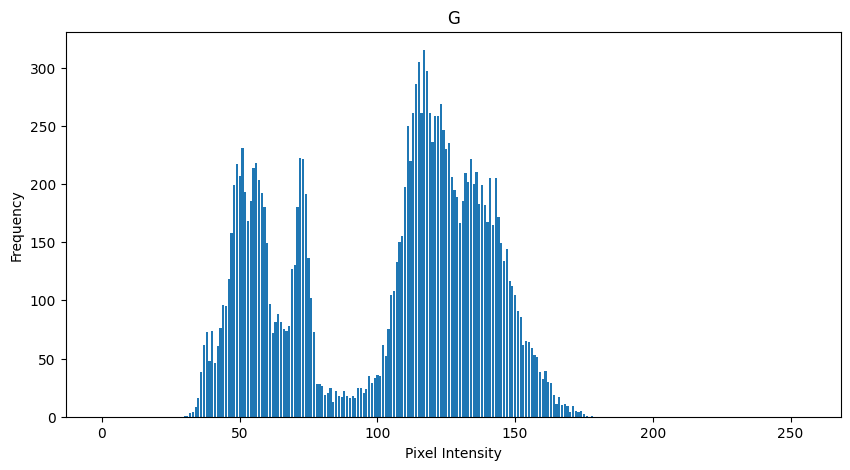

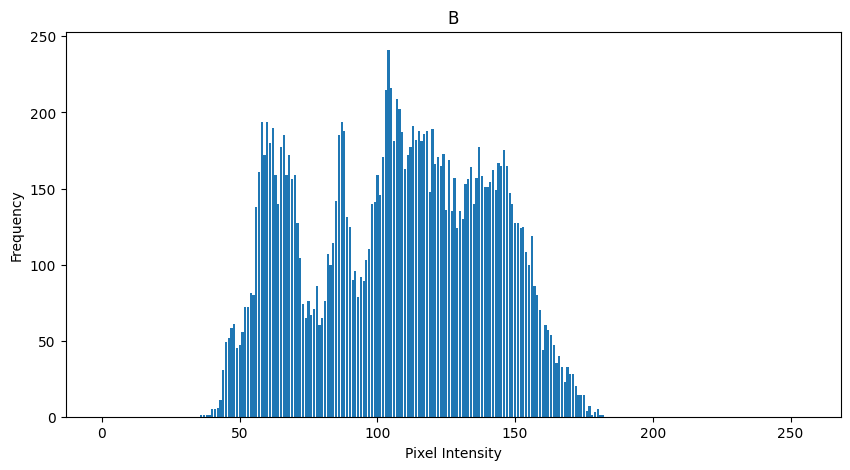

Red channel histogram was chosen.


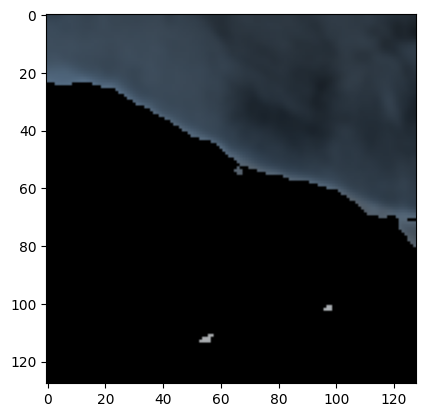

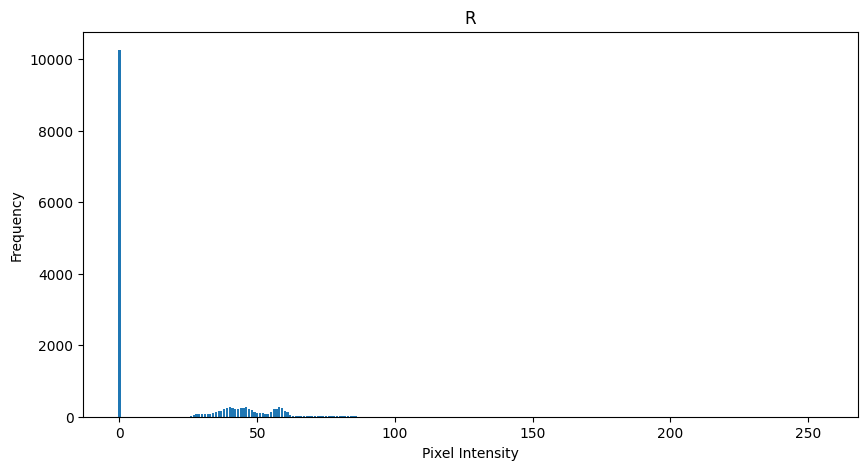

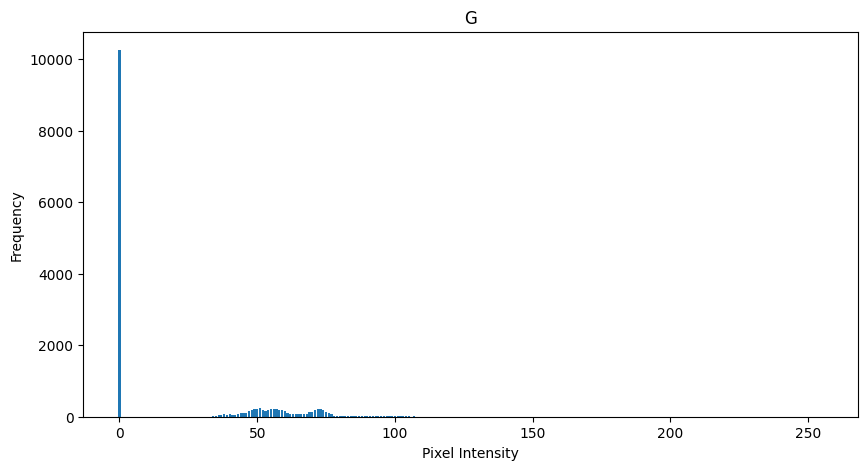

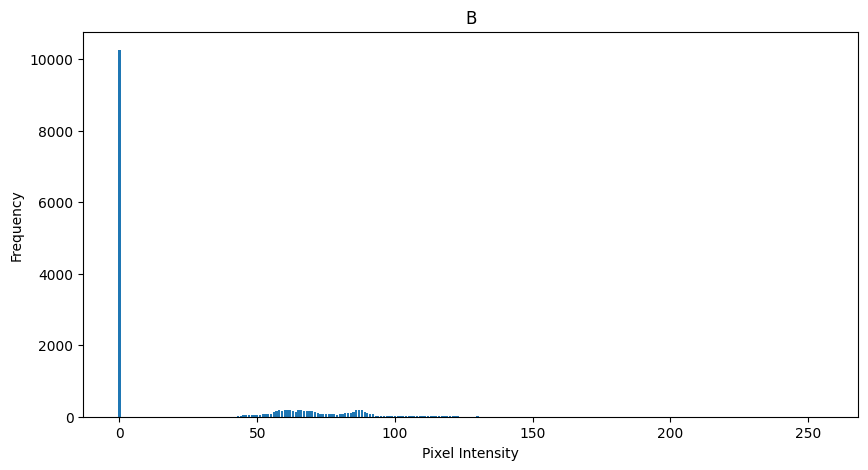

Red channel histogram was chosen.
Nombre de pixels restants (42) insuffisant pour continuer.


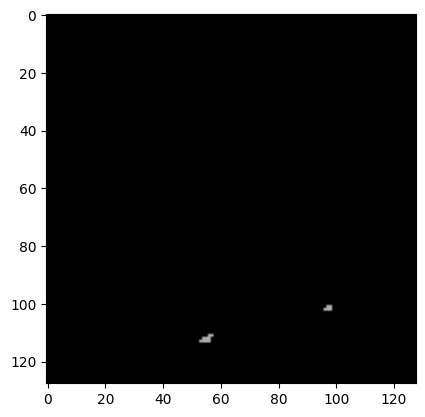

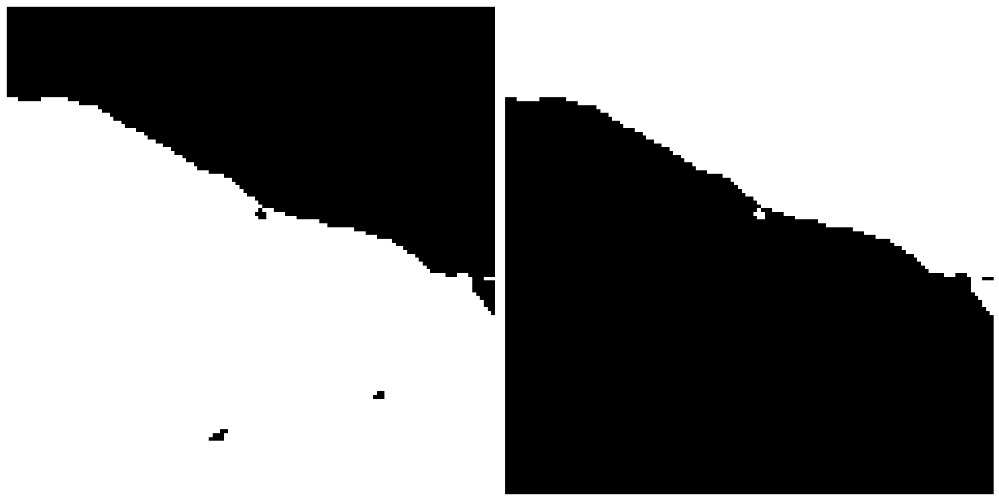

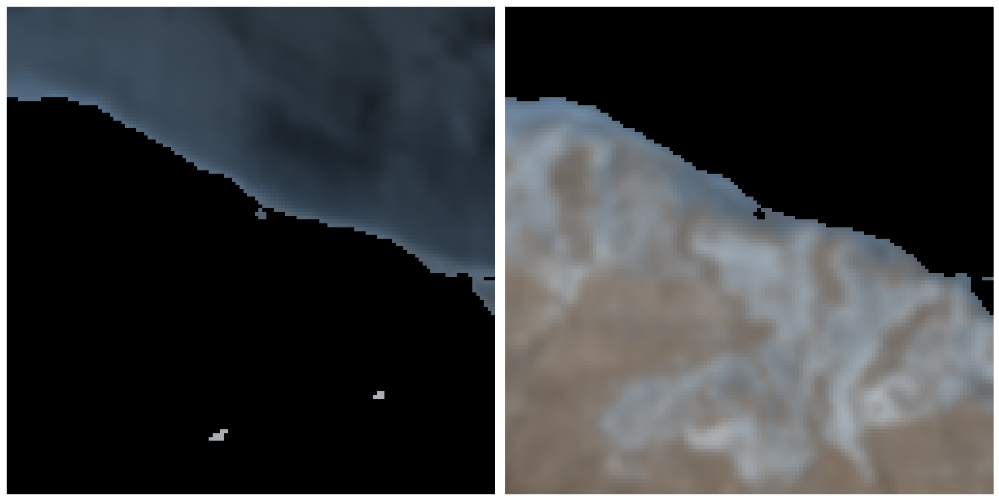

In [62]:
resized_image = img2.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_img = gaussian_filter(resized_image, sigma=1.5)  

segmentes, segmented_images = segments_image(smoothed_img, 40)
n = len(segmented_images)
display_images_in_grid(segmentes,['','',''],1,n,False,True)
display_images_in_grid(segmented_images,['','',''],1,n,False,True)

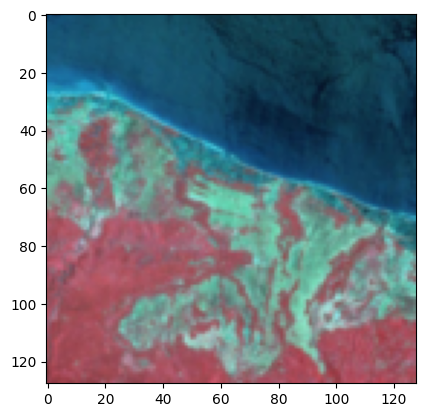

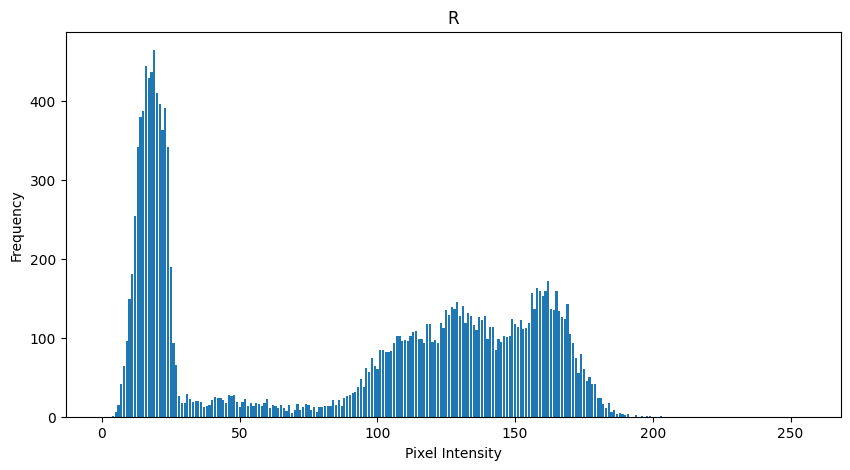

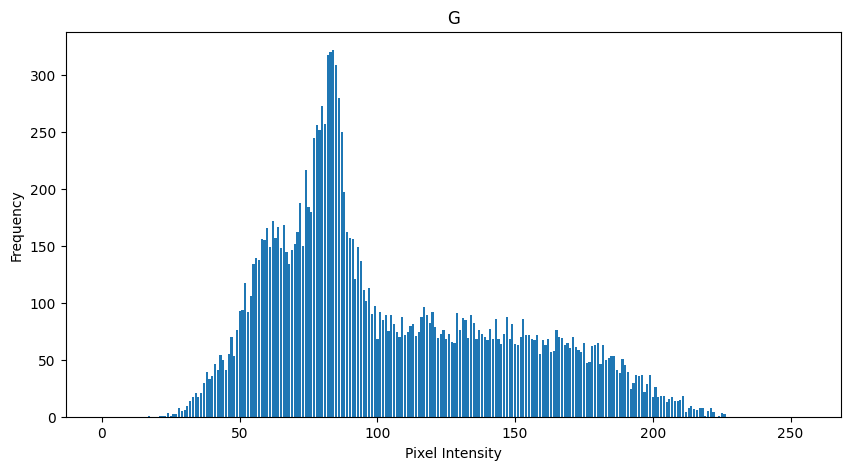

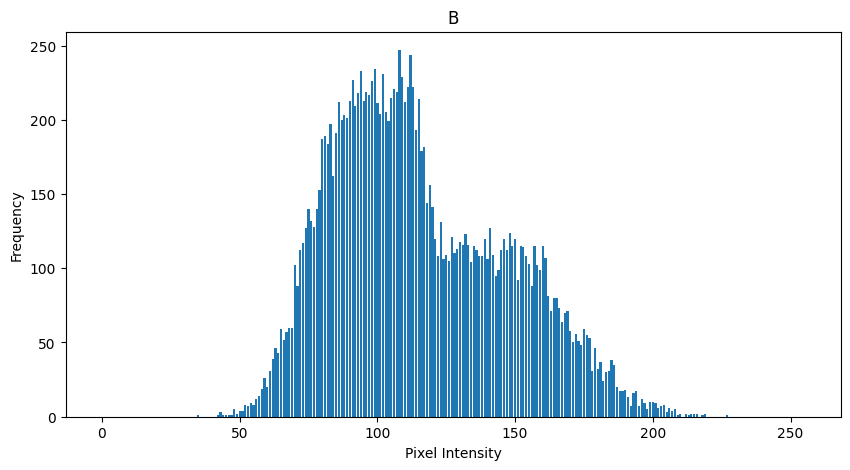

Red channel histogram was chosen.


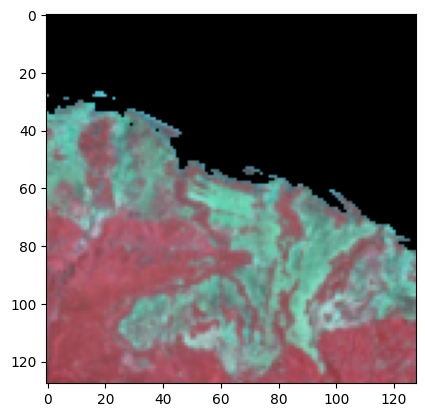

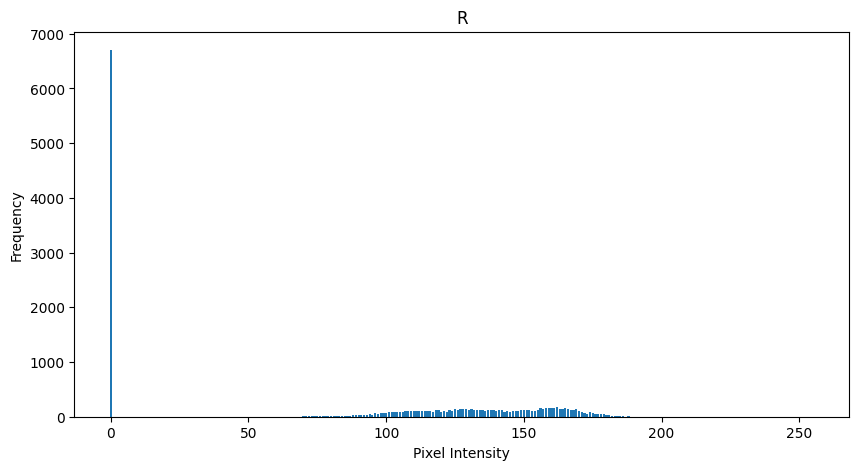

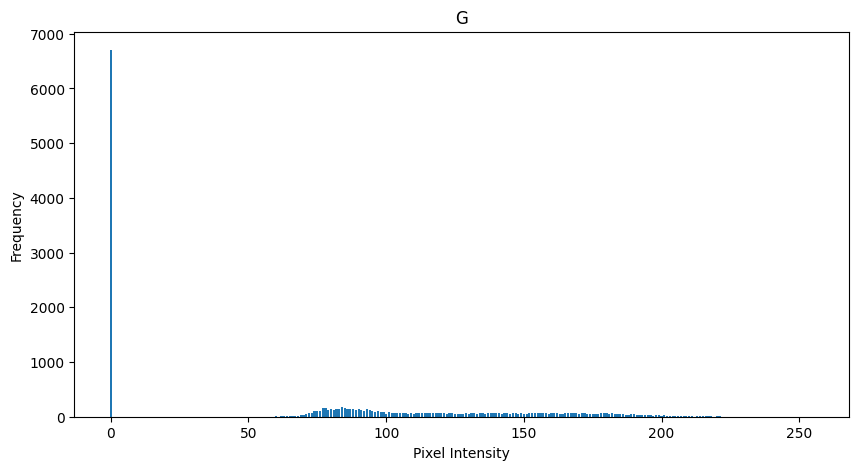

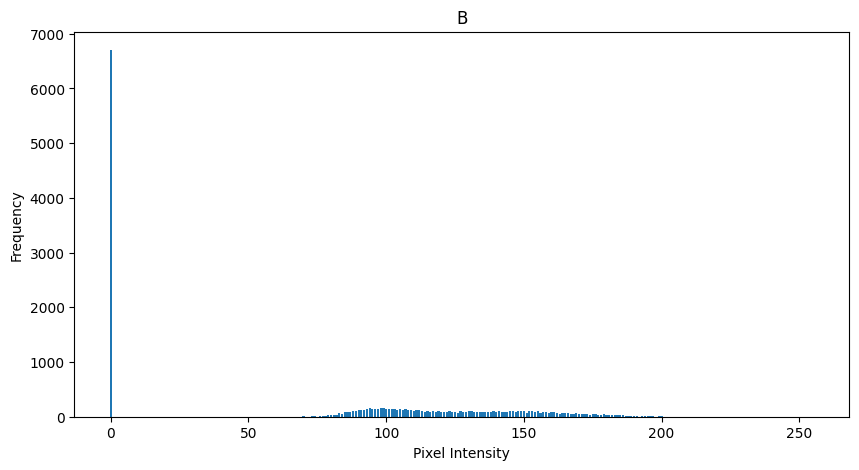

Red channel histogram was chosen.


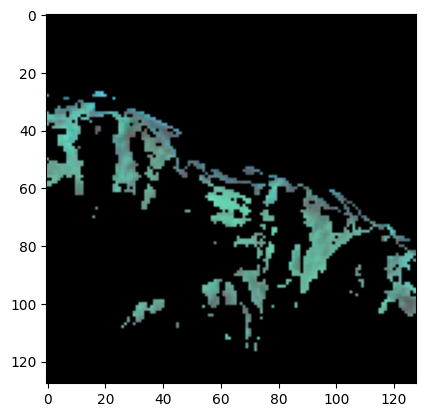

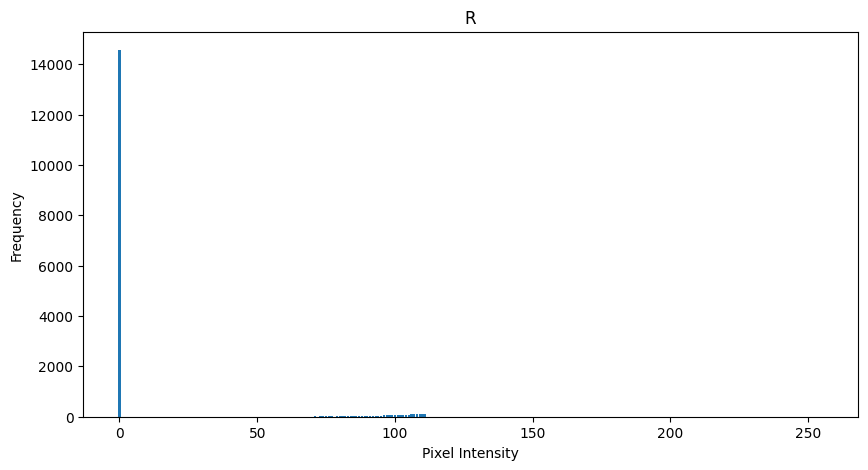

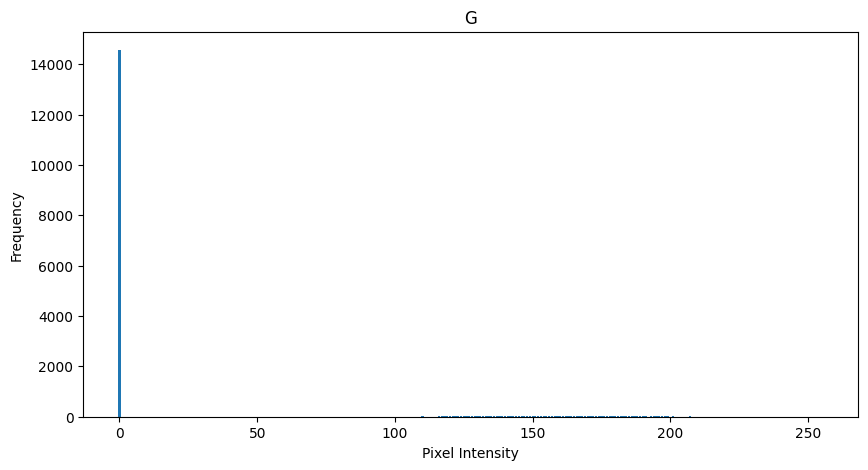

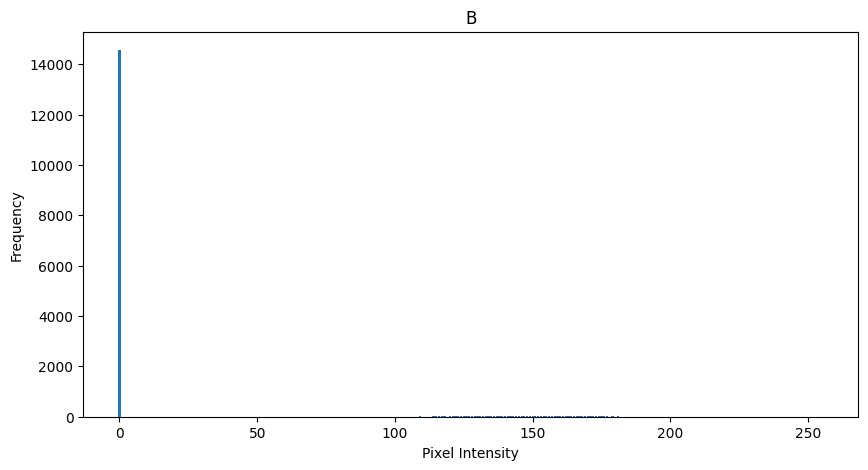

Red channel histogram was chosen.
Nombre de pixels restants (0) insuffisant pour continuer.


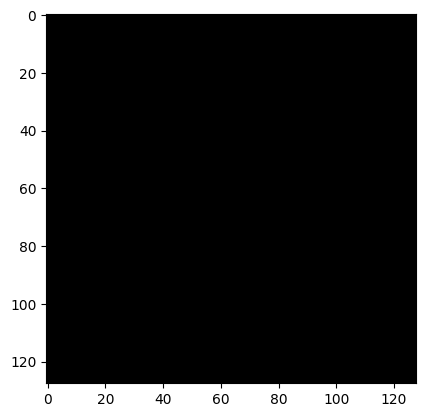

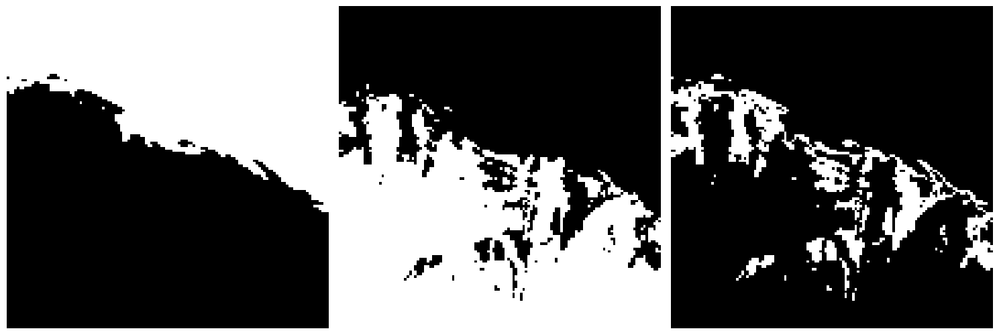

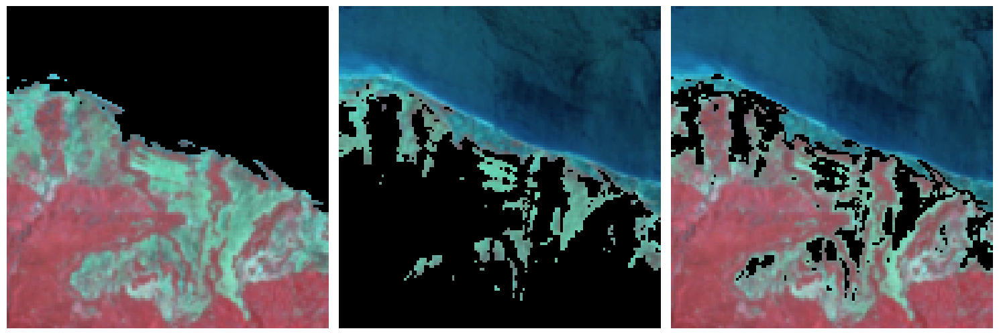

In [63]:
resized_image = img2.resize((128, 128)) 
red, green, blue = Split_RGB(resized_image)
smoothed_img = gaussian_filter(resized_image, sigma=0.5)  

segmentes, segmented_images = segments_image(smoothed_img, 50)
n = len(segmented_images)
display_images_in_grid(segmentes,['','',''],1,n,False,True)
display_images_in_grid(segmented_images,['','',''],1,n,False,True)

# Etape 3 : Classification

In [43]:
def prepare_data(image):
    height, width, _ = image.shape
    x_coords, y_coords = np.meshgrid(np.arange(width), np.arange(height))
    red, green, blue = image[:, :, 0].flatten(), image[:, :, 1].flatten(), image[:, :, 2].flatten()
    x_coords, y_coords = x_coords.flatten(), y_coords.flatten()
    
    # all data signle array
    data = np.column_stack((red, green, blue, x_coords, y_coords)).astype(float)
    return data


In [40]:
def calculate_manhattan_distances(data, centroids):
    n_samples = data.shape[0]
    k = centroids.shape[0]
    distances = np.zeros((n_samples, k))
    
    for i in range(n_samples):
        for j in range(k):
            distances[i, j] = np.sum(np.abs(data[i] - centroids[j]))
    
    return distances


In [45]:
def find_min_indices(distances):
    n_samples = distances.shape[0]
    min_indices = np.zeros(n_samples, dtype=int)
    
    for i in range(n_samples):
        min_value = float('inf') 
        min_index = -1  # Indice initial

        for j in range(distances.shape[1]):  # Parcourt chaque colonne de la ligne
            if distances[i, j] < min_value:
                min_value = distances[i, j]
                min_index = j
        
        min_indices[i] = min_index  # Stocke l'indice du minimum pour cette ligne

    return min_indices


In [48]:
def manual_median(array):

    medians = []
    for col in range(array.shape[1]):
        sorted_col = sorted(array[:, col])  # Trie 
        n = len(sorted_col)
        if n % 2 == 0:  # Nbr pair *
            median = (sorted_col[n // 2 - 1] + sorted_col[n // 2]) / 2
        else:  # Nbr impair 
            median = sorted_col[n // 2]
        medians.append(median)
    return np.array(medians)


In [54]:
def check_convergence(new_centroids, centroids, tolerance):
    n_clusters, n_features = new_centroids.shape
    
    for i in range(n_clusters):
        for j in range(n_features):
            if abs(new_centroids[i, j] - centroids[i, j]) >= tolerance:
                return False  # Arrête dès qu'une condition n'est pas remplie
    
    return True  # Si toutes les conditions sont remplies


In [56]:
def k_medians(data, k,titre, max_iterations=100, tolerance=1e-4):
    # Randomly initialize centroids
    print(titre)
    np.random.seed(42)
    centroids = data[np.random.choice(data.shape[0], k, replace=False)]
    
    for iteration in range(max_iterations):

        distances = calculate_manhattan_distances(data, centroids)  # Manhattan distance
        labels = find_min_indices(distances)
        
        
        #  new centroids as the median
        new_centroids = np.zeros_like(centroids)
        for i in range(k):
            cluster_points = data[labels == i]
            if len(cluster_points) > 0: 
                new_centroids[i] = manual_median(cluster_points)
            else:  # if not attribu
                new_centroids[i] = data[np.random.choice(data.shape[0])]
        
        # Check convergence 
        if check_convergence(new_centroids,centroids,tolerance):
            print(f"Converged after {iteration + 1} iterations.")
            break
        
        centroids = new_centroids
    
    return centroids, labels

true color k=3
Converged after 7 iterations.
false color k=3
Converged after 8 iterations.
true color k=5
Converged after 12 iterations.
false color k=5
Converged after 18 iterations.


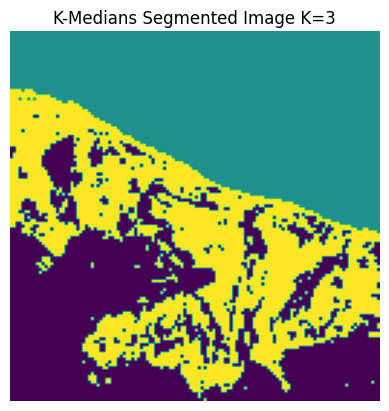

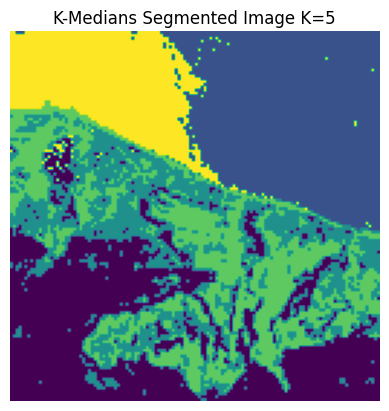

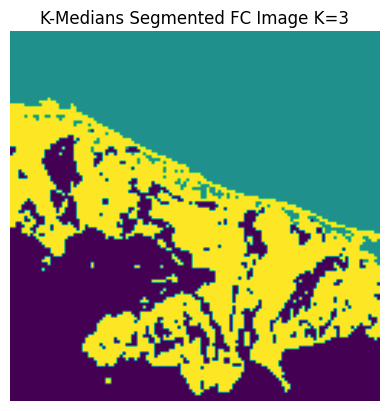

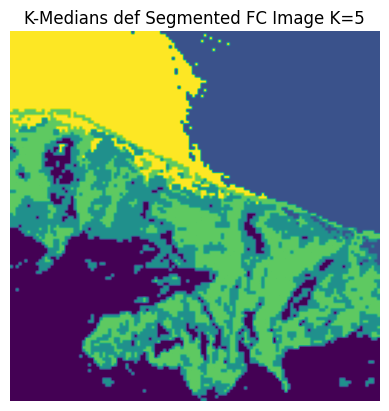

In [57]:
image_path = "imag sat/NaturalColorImages.jpg"
img_one = Image.open(image_path).resize((128, 128))
image_array = np.array(img_one)

image_path2 = "imag sat/FalseColorImages.jpg"
img_two = Image.open(image_path2).resize((128, 128))
image_array2 = np.array(img_two)


data = prepare_data(image_array)
data2 = prepare_data(image_array2)

k5, k3 = 5, 3
centroids3, labels3 = k_medians(data, k3,'true color k=3')

centroids3_fc, labels3_fc = k_medians(data2, k3,'false color k=3')

centroids5, labels5 = k_medians(data, k5,'true color k=5')

centroids5_fc, labels5_fc = k_medians(data2, k5,'false color k=5')


# Reshape labels to match the image shape
segmented_img = labels3.reshape(img_one.size[::-1])
segmented_img5 = labels5.reshape(img_one.size[::-1])

segmented_img_fc = labels3_fc.reshape(img_one.size[::-1])
segmented_img_fc_5 = labels5_fc.reshape(img_one.size[::-1])
#segmented_img_def = labels_def.reshape(img.size[::-1])

# Display the clustered image
plt.imshow(segmented_img, cmap='viridis')
plt.title("K-Medians Segmented Image K=3")
plt.axis("off")
plt.show()

plt.imshow(segmented_img5, cmap='viridis')
plt.title("K-Medians Segmented Image K=5")
plt.axis("off")
plt.show()

plt.imshow(segmented_img_fc, cmap='viridis')
plt.title("K-Medians Segmented FC Image K=3")
plt.axis("off")
plt.show()

plt.imshow(segmented_img_fc_5, cmap='viridis')
plt.title("K-Medians def Segmented FC Image K=5")
plt.axis("off")
plt.show()